# **Car Detection**

### **DOMAIN**: 
Automotive Surveillance.
### **CONTEXT**: 
Computer  vision  can  be  used  to  automate  supervision  and  generate  action  appropriate  action  trigger  if  the  event  is predicted from the image of interest. For example a car moving on the road can be easily identified by a camera as make of the car, type, colour, number plates etc. 
### **DATA DESCRIPTION**:
The Cars dataset contains 16,185 images of 196 classes of cars. The data is split into 8,144 training images and 8,041 testing images, where each class has been split roughly in a 50-50 split. Classes are typically at the level of Make, Model, Year, e.g. 2012 Tesla Model S or 2012 BMW M3 coupe.
##### **Data description**: 
* Train Images: Consists of real images of cars as per the make and year of the car. 
* Test Images: Consists of real images of cars as per the make and year of the car.
* Train Annotation: Consists of bounding box region for training images.
* Test Annotation: Consists of bounding box region for testing images.



In [ ]:
!pwd

/content


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


---

In [ ]:
!pip install console-progressbar
!pip install efficientnet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for console-progressbar: filename=console_progressbar-1.1.2-py3-none-any.whl size=4156 sha256=d5bcbc81ea516664d2fc174e74d435a274ebd81d72c1aaeb479d5584320d359c
  Stored in directory: /root/.cache/pip/wheels/a6/ed/f4/fbee97c7d412f5b7807f8592c8aa20c9d3722a32f1c75ac6ed
Successfully built console-progressbar
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 KB 2.7 MB/s eta 0:00:00


### Import Packages

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import keras
import os
import warnings
warnings.filterwarnings("ignore")
from zipfile import ZipFile
import shutil
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, Model
from keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, BatchNormalization
from keras.layers import Activation, Dropout, Flatten, Dense, Input
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint, Callback
from keras.optimizers import SGD, Adam
from keras import regularizers
from keras import backend as K
import cv2
import tarfile
import random
from console_progressbar import ProgressBar
from efficientnet.keras import center_crop_and_resize, preprocess_input
from keras.applications.imagenet_utils import decode_predictions
from efficientnet.keras import EfficientNetB3
import keras.callbacks as callbacks
from keras.applications import densenet
from keras.applications import InceptionResNetV2
from keras.applications.mobilenet import MobileNet
from tqdm import tqdm_notebook
import scipy.io as sio

---


Step 1: Import the data

In [ ]:
os.chdir("/content/drive/MyDrive/ColabNotebooks")

In [ ]:
os.listdir()

['Annotations.zip',
 'Car+names+and+make.csv',
 'Car+Images.zip',
 'CapstoneProject_Group1_CV2_Rudra.ipynb',
 'CapstoneProject_Group1_CV2_Master.ipynb',
 'CapstoneProject_Group1_CV2_Ankit.ipynb',
 'Car_names_and_make.csv',
 'Car_Images.zip',
 'Annotations',
 'Car Images',
 'data',
 'result.txt',
 'densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5',
 'CapstoneProject_Group1_CV2_Dharmes.ipynb',
 'CapstoneProject_Group1_CV2_Raju.ipynb',
 'keras_swa_en.model.index',
 'keras_swa_en.model.data-00000-of-00001',
 'keras_swa_dn.model.index',
 'keras_swa_dn.model.data-00000-of-00001',
 'keras_swa_ir.model.index',
 'keras_swa_ir.model.data-00000-of-00001',
 'keras_swa_mn.model.data-00000-of-00001',
 'keras_swa_mn.model.index',
 'Milestone1_Submission',
 'model.png',
 'keras_swa.model.index',
 'checkpoint',
 'keras_swa.model.data-00000-of-00001',
 'CapstoneProject_Group1_CV2_Sandeep.ipynb']

In [ ]:
isExist = os.path.exists('Car Images')
print(isExist)

True


In [ ]:
if not os.path.exists('Car_names_and_make.csv'):
  shutil.copy('Car+names+and+make.csv', 'Car_names_and_make.csv')

In [ ]:
if not os.path.exists('Car_Images.zip'):
  shutil.copy('Car+Images.zip', 'Car_Images.zip')

In [ ]:
os.listdir()

['Annotations.zip',
 'Car+names+and+make.csv',
 'Car+Images.zip',
 'CapstoneProject_Group1_CV2_Rudra.ipynb',
 'CapstoneProject_Group1_CV2_Master.ipynb',
 'CapstoneProject_Group1_CV2_Ankit.ipynb',
 'Car_names_and_make.csv',
 'Car_Images.zip',
 'Annotations',
 'Car Images',
 'data',
 'result.txt',
 'densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5',
 'CapstoneProject_Group1_CV2_Dharmes.ipynb',
 'CapstoneProject_Group1_CV2_Raju.ipynb',
 'keras_swa_en.model.index',
 'keras_swa_en.model.data-00000-of-00001',
 'keras_swa_dn.model.index',
 'keras_swa_dn.model.data-00000-of-00001',
 'keras_swa_ir.model.index',
 'keras_swa_ir.model.data-00000-of-00001',
 'model.png',
 'keras_swa_mn.model.data-00000-of-00001',
 'keras_swa_mn.model.index',
 'checkpoint',
 'Milestone1_Submission',
 'CapstoneProject_Group1_CV2_Sandeep.ipynb']

In [ ]:
if not os.path.exists('Annotations'):
  with ZipFile('Annotations.zip','r') as z:
      z.extractall()

In [ ]:
os.listdir('./Annotations')

['Train Annotations.csv',
 'Test Annotation.csv',
 'Train_Annotations.csv',
 'Test_Annotation.csv']

In [ ]:
if not os.path.exists('./Annotations/Train_Annotations.csv'):
  shutil.copy('./Annotations/Train Annotations.csv', './Annotations/Train_Annotations.csv')

In [ ]:
if not os.path.exists('./Annotations/Test_Annotation.csv'):
  shutil.copy('./Annotations/Test Annotation.csv', './Annotations/Test_Annotation.csv')

In [ ]:
os.listdir('./Annotations')

['Train Annotations.csv',
 'Test Annotation.csv',
 'Train_Annotations.csv',
 'Test_Annotation.csv']

In [ ]:
if not os.path.exists('Car Images'):
  with ZipFile('Car_Images.zip','r') as z:
      z.extractall()

In [ ]:
train_anno = pd.read_csv('./Annotations/Train_Annotations.csv')
print(train_anno.shape)
train_anno.head()

(8144, 6)


,Image Name,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,39,116,569,375,14
1,00002.jpg,36,116,868,587,3
2,00003.jpg,85,109,601,381,91
3,00004.jpg,621,393,1484,1096,134
4,00005.jpg,14,36,133,99,106


In [ ]:
test_anno = pd.read_csv('./Annotations/Test_Annotation.csv')
print(test_anno.shape)
test_anno.head()

(8041, 6)


,Image Name,Bounding Box coordinates,Unnamed: 2,Unnamed: 3,Unnamed: 4,Image class
0,00001.jpg,30,52,246,147,181
1,00002.jpg,100,19,576,203,103
2,00003.jpg,51,105,968,659,145
3,00004.jpg,67,84,581,407,187
4,00005.jpg,140,151,593,339,185


In [ ]:
train_anno.columns

Index(['Image Name', 'Bounding Box coordinates', 'Unnamed: 2', 'Unnamed: 3',
       'Unnamed: 4', 'Image class'],
      dtype='object')

In [ ]:
train_anno.rename(columns={'Image Name': 'image_name', 'Bounding Box coordinates': 'bbox_x1', 'Unnamed: 2': 'bbox_y1', 'Unnamed: 3' : 'bbox_x2',
       'Unnamed: 4': 'bbox_y2', 'Image class': 'image_class'}, inplace= True)
test_anno.rename(columns={'Image Name': 'image_name', 'Bounding Box coordinates': 'bbox_x1', 'Unnamed: 2': 'bbox_y1', 'Unnamed: 3' : 'bbox_x2',
       'Unnamed: 4': 'bbox_y2', 'Image class': 'image_class'}, inplace= True)

In [ ]:
train_anno.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class
0,00001.jpg,39,116,569,375,14
1,00002.jpg,36,116,868,587,3
2,00003.jpg,85,109,601,381,91
3,00004.jpg,621,393,1484,1096,134
4,00005.jpg,14,36,133,99,106


In [ ]:
test_anno.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class
0,00001.jpg,30,52,246,147,181
1,00002.jpg,100,19,576,203,103
2,00003.jpg,51,105,968,659,145
3,00004.jpg,67,84,581,407,187
4,00005.jpg,140,151,593,339,185


In [ ]:
np.min(train_anno.image_class)

1

In [ ]:
np.min(test_anno.image_class)

1

In [ ]:
name_make_df = pd.read_csv('Car_names_and_make.csv', header=None, names=['car_make'])

In [ ]:
name_make_df['image_class'] = name_make_df.index+1

In [ ]:
name_make_df.head(14)

,car_make,image_class
0,AM General Hummer SUV 2000,1
1,Acura RL Sedan 2012,2
2,Acura TL Sedan 2012,3
3,Acura TL Type-S 2008,4
4,Acura TSX Sedan 2012,5
5,Acura Integra Type R 2001,6
6,Acura ZDX Hatchback 2012,7
7,Aston Martin V8 Vantage Convertible 2012,8
8,Aston Martin V8 Vantage Coupe 2012,9
9,Aston Martin Virage Convertible 2012,10


In [ ]:
name_make_df.car_make = name_make_df.car_make.apply(lambda x:x.replace("/", '-'))


Step 2: Map training and testing images to its classes.

In [ ]:
train_df = pd.merge(train_anno, name_make_df)
train_df.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make
0,00001.jpg,39,116,569,375,14,Audi TTS Coupe 2012
1,00017.jpg,39,52,233,150,14,Audi TTS Coupe 2012
2,00411.jpg,52,47,586,260,14,Audi TTS Coupe 2012
3,00467.jpg,47,92,209,178,14,Audi TTS Coupe 2012
4,00888.jpg,7,51,253,156,14,Audi TTS Coupe 2012


In [ ]:
test_df = pd.merge(test_anno, name_make_df)
test_df.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make
0,00001.jpg,30,52,246,147,181,Suzuki Aerio Sedan 2007
1,00055.jpg,84,169,561,443,181,Suzuki Aerio Sedan 2007
2,00323.jpg,12,31,489,226,181,Suzuki Aerio Sedan 2007
3,00540.jpg,7,121,635,357,181,Suzuki Aerio Sedan 2007
4,00541.jpg,9,42,282,207,181,Suzuki Aerio Sedan 2007


In [ ]:
os.listdir()

['Annotations.zip',
 'Car+names+and+make.csv',
 'Car+Images.zip',
 'CapstoneProject_Group1_CV2_Rudra.ipynb',
 'CapstoneProject_Group1_CV2_Master.ipynb',
 'CapstoneProject_Group1_CV2_Ankit.ipynb',
 'Car_names_and_make.csv',
 'Car_Images.zip',
 'Annotations',
 'Car Images',
 'data',
 'result.txt',
 'densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5',
 'CapstoneProject_Group1_CV2_Dharmes.ipynb',
 'CapstoneProject_Group1_CV2_Raju.ipynb',
 'keras_swa_en.model.index',
 'keras_swa_en.model.data-00000-of-00001',
 'keras_swa_dn.model.index',
 'keras_swa_dn.model.data-00000-of-00001',
 'keras_swa_ir.model.index',
 'keras_swa_ir.model.data-00000-of-00001',
 'keras_swa_mn.model.data-00000-of-00001',
 'keras_swa_mn.model.index',
 'Milestone1_Submission',
 'model.png',
 'keras_swa.model.index',
 'checkpoint',
 'keras_swa.model.data-00000-of-00001',
 'CapstoneProject_Group1_CV2_Sandeep.ipynb']

In [ ]:
os.listdir('./Car Images')

['.DS_Store', 'Train Images', 'Test Images']

In [ ]:

base_path = '/content/drive/MyDrive/ColabNotebooks'
train_data_dir = '/Car Images/Train Images'
test_data_dir = '/Car Images/Test Images'

In [ ]:
print(os.listdir(base_path + train_data_dir))

['Volkswagen Golf Hatchback 2012', 'Rolls-Royce Phantom Drophead Coupe Convertible 2012', 'Toyota Corolla Sedan 2012', 'Rolls-Royce Ghost Sedan 2012', 'Scion xD Hatchback 2012', 'Volvo C30 Hatchback 2012', 'Spyker C8 Convertible 2009', 'Spyker C8 Coupe 2009', 'Suzuki SX4 Sedan 2012', 'Rolls-Royce Phantom Sedan 2012', 'Toyota Camry Sedan 2012', 'Suzuki Aerio Sedan 2007', 'Volkswagen Beetle Hatchback 2012', 'Volvo 240 Sedan 1993', 'Mercedes-Benz SL-Class Coupe 2009', 'Toyota 4Runner SUV 2012', 'Volvo XC90 SUV 2007', 'Suzuki Kizashi Sedan 2012', 'smart fortwo Convertible 2012', 'Volkswagen Golf Hatchback 1991', 'Ram C-V Cargo Van Minivan 2012', 'Suzuki SX4 Hatchback 2012', 'Toyota Sequoia SUV 2012', 'Tesla Model S Sedan 2012', 'Plymouth Neon Coupe 1999', 'Jeep Liberty SUV 2012', 'Fisker Karma Sedan 2012', 'Mercedes-Benz 300-Class Convertible 1993', 'Porsche Panamera Sedan 2012', 'Dodge Sprinter Cargo Van 2009', 'Hyundai Accent Sedan 2012', 'Honda Accord Coupe 2012', 'GMC Yukon Hybrid SUV 

In [ ]:
print(os.listdir(base_path + train_data_dir + '/AM General Hummer SUV 2000'))

['04544.jpg', '00522.jpg', '07279.jpg', '07966.jpg', '01661.jpg', '05754.jpg', '00773.jpg', '02145.jpg', '01277.jpg', '05804.jpg', '05224.jpg', '08031.jpg', '02363.jpg', '05657.jpg', '01952.jpg', '02050.jpg', '00163.jpg', '06052.jpg', '06174.jpg', '04578.jpg', '07684.jpg', '06262.jpg', '01918.jpg', '00462.jpg', '03943.jpg', '08011.jpg', '02311.jpg', '04874.jpg', '04827.jpg', '00887.jpg', '05921.jpg', '00707.jpg', '01832.jpg', '04056.jpg', '02848.jpg', '06833.jpg', '00946.jpg', '04669.jpg', '06159.jpg', '07025.jpg', '07290.jpg', '03008.jpg', '05030.jpg', '07487.jpg', '03393.jpg']


In [ ]:
# Write a function to read image using opencv and convert it from BGR to RGB
def load_image(path):
    img = cv2.imread(path, 1)
    # OpenCV loads imgs with color channels in BGR order, converting it
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img_rgb

In [ ]:
train_df['image_path'] = base_path + train_data_dir + '/' + train_df.car_make + '/' + train_df.image_name
train_df.image_path = train_df.image_path.astype('string')

In [ ]:
train_df.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make,image_path
0,00001.jpg,39,116,569,375,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
1,00017.jpg,39,52,233,150,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
2,00411.jpg,52,47,586,260,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
3,00467.jpg,47,92,209,178,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
4,00888.jpg,7,51,253,156,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...


In [ ]:
train_df.iloc[4291]['image_path']

'/content/drive/MyDrive/ColabNotebooks/Car Images/Train Images/Buick Regal GS 2012/07940.jpg'

In [ ]:
img = load_image(train_df.image_path[4291])
img

array([[[ 36,  50,  14],
        [ 35,  49,  13],
        [ 33,  47,  11],
        ...,
        [ 35,  46,   4],
        [ 35,  46,   4],
        [ 35,  46,   4]],

       [[ 34,  48,  12],
        [ 33,  47,  11],
        [ 32,  46,  10],
        ...,
        [ 38,  49,   7],
        [ 38,  49,   7],
        [ 38,  49,   7]],

       [[ 31,  45,   9],
        [ 31,  45,   9],
        [ 30,  44,   8],
        ...,
        [ 37,  48,   5],
        [ 37,  48,   5],
        [ 37,  48,   5]],

       ...,

       [[103,  95,  74],
        [103,  95,  74],
        [102,  94,  73],
        ...,
        [114, 101,  92],
        [114, 101,  92],
        [114, 101,  92]],

       [[103,  95,  74],
        [103,  95,  74],
        [102,  94,  73],
        ...,
        [115, 102,  93],
        [115, 102,  93],
        [115, 102,  93]],

       [[103,  95,  74],
        [103,  95,  74],
        [102,  94,  73],
        ...,
        [116, 103,  94],
        [116, 103,  94],
        [116, 103,  94]]

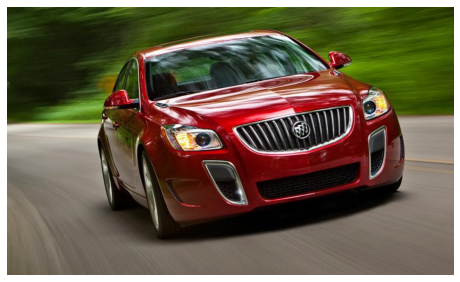

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
image=cv2.rectangle(img,(train_df.bbox_x1[4291],train_df.bbox_y1[4291]),(train_df.bbox_x2[4291],train_df.bbox_y2[4291]),(0,0,255),2)

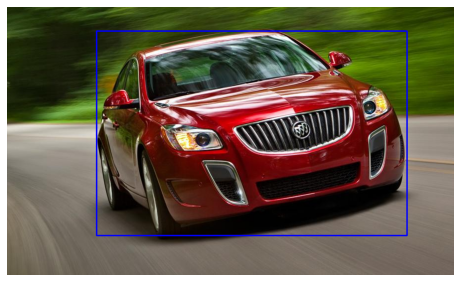

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(image)
plt.axis('off')
plt.show()

In [ ]:
test_df = pd.merge(test_anno, name_make_df)
test_df['image_path'] = base_path + test_data_dir + '/' + test_df.car_make + '/' + test_df.image_name
test_df.image_path = test_df.image_path.astype('string')
test_df.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make,image_path
0,00001.jpg,30,52,246,147,181,Suzuki Aerio Sedan 2007,/content/drive/MyDrive/ColabNotebooks/Car Imag...
1,00055.jpg,84,169,561,443,181,Suzuki Aerio Sedan 2007,/content/drive/MyDrive/ColabNotebooks/Car Imag...
2,00323.jpg,12,31,489,226,181,Suzuki Aerio Sedan 2007,/content/drive/MyDrive/ColabNotebooks/Car Imag...
3,00540.jpg,7,121,635,357,181,Suzuki Aerio Sedan 2007,/content/drive/MyDrive/ColabNotebooks/Car Imag...
4,00541.jpg,9,42,282,207,181,Suzuki Aerio Sedan 2007,/content/drive/MyDrive/ColabNotebooks/Car Imag...


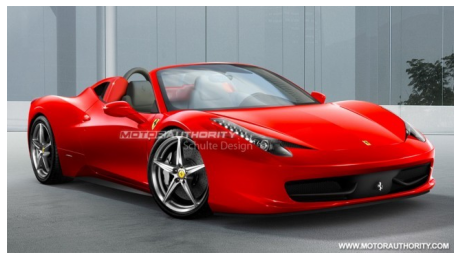

In [ ]:
tst_img = load_image(test_df.image_path[46])
plt.figure(figsize=(8,8))
plt.imshow(tst_img)
plt.axis('off')
plt.show()

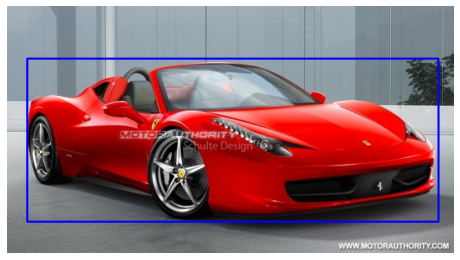

In [ ]:
tst_image=cv2.rectangle(tst_img,(test_df.bbox_x1[46],test_df.bbox_y1[46]),(test_df.bbox_x2[46],test_df.bbox_y2[46]),(0,0,255),2)
plt.figure(figsize=(8,8))
plt.imshow(tst_image)
plt.axis('off')
plt.show()

### EDA - Train

In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8144 entries, 0 to 8143
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image_name   8144 non-null   object
 1   bbox_x1      8144 non-null   int64 
 2   bbox_y1      8144 non-null   int64 
 3   bbox_x2      8144 non-null   int64 
 4   bbox_y2      8144 non-null   int64 
 5   image_class  8144 non-null   int64 
 6   car_make     8144 non-null   object
 7   image_path   8144 non-null   string
dtypes: int64(5), object(2), string(1)
memory usage: 830.7+ KB


In [ ]:
train_df.describe(include='all')

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make,image_path
count,8144,8144.000000,8144.000000,8144.000000,8144.000000,8144.000000,8144,8144
unique,8144,NaN,NaN,NaN,NaN,NaN,196,8144
top,00001.jpg,NaN,NaN,NaN,NaN,NaN,GMC Savana Van 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
freq,1,NaN,NaN,NaN,NaN,NaN,68,1
mean,NaN,64.906803,108.661223,638.208620,416.431606,98.979371,NaN,NaN
std,NaN,82.198684,104.551635,410.776734,273.786000,56.503148,NaN,NaN
min,NaN,1.000000,1.000000,76.000000,47.000000,1.000000,NaN,NaN
25%,NaN,19.000000,42.000000,392.000000,248.000000,50.000000,NaN,NaN
50%,NaN,39.000000,80.000000,569.000000,360.000000,99.000000,NaN,NaN
75%,NaN,79.000000,138.250000,746.250000,477.000000,148.000000,NaN,NaN


In [ ]:
train_df.nunique()

image_name     8144
bbox_x1         418
bbox_y1         527
bbox_x2        1429
bbox_y2        1116
image_class     196
car_make        196
image_path     8144
dtype: int64

In [ ]:
train_df.columns

Index(['image_name', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class',
       'car_make', 'image_path'],
      dtype='object')

In [ ]:
train_df.isnull().values.any()

False

In [ ]:
train_df.isnull().sum() 

image_name     0
bbox_x1        0
bbox_y1        0
bbox_x2        0
bbox_y2        0
image_class    0
car_make       0
image_path     0
dtype: int64

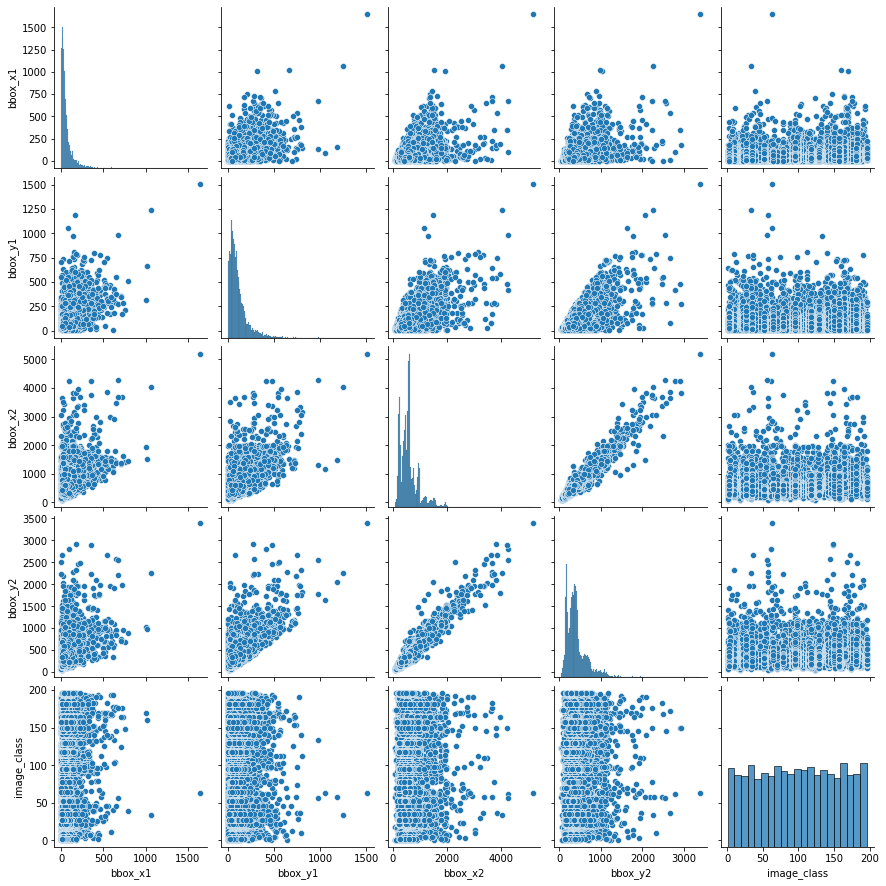

In [ ]:
sns.pairplot(train_df);

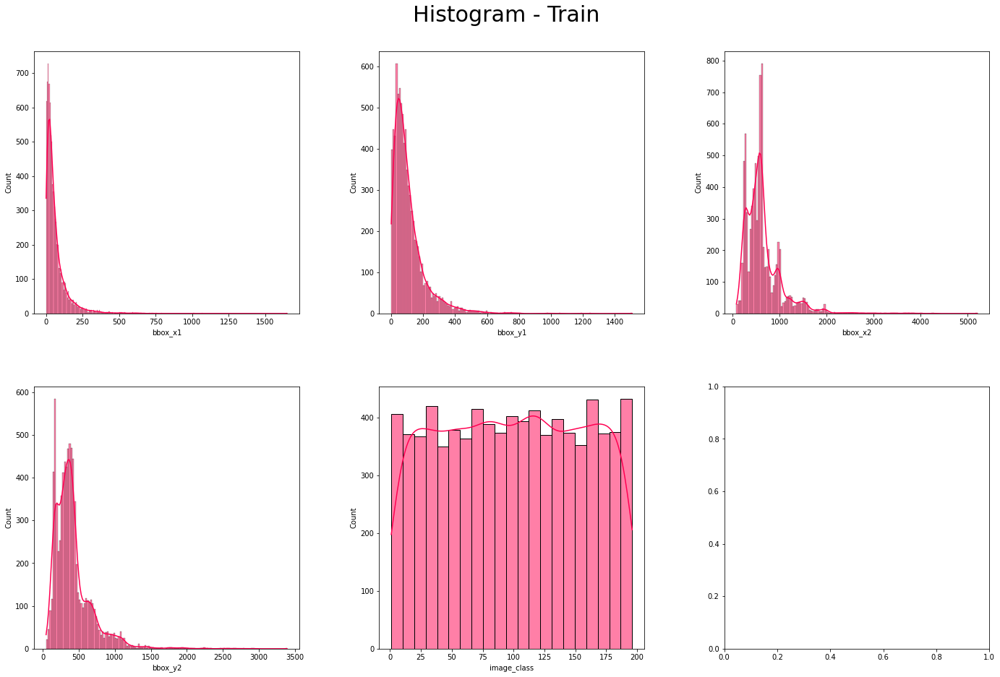

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('Histogram - Train', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.histplot(data=train_df, x=col, kde=True, ax=axes[x_axes,y_axes], color='#ff0051')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

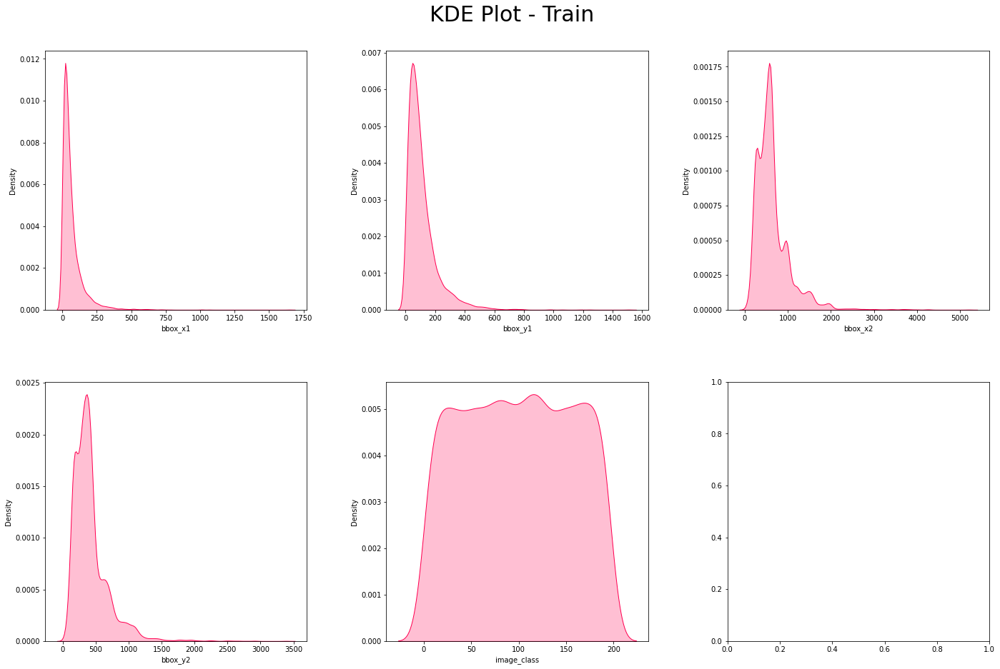

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('KDE Plot - Train', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.kdeplot(data=train_df, x=col, shade=True, ax=axes[x_axes,y_axes], color='#ff0051')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

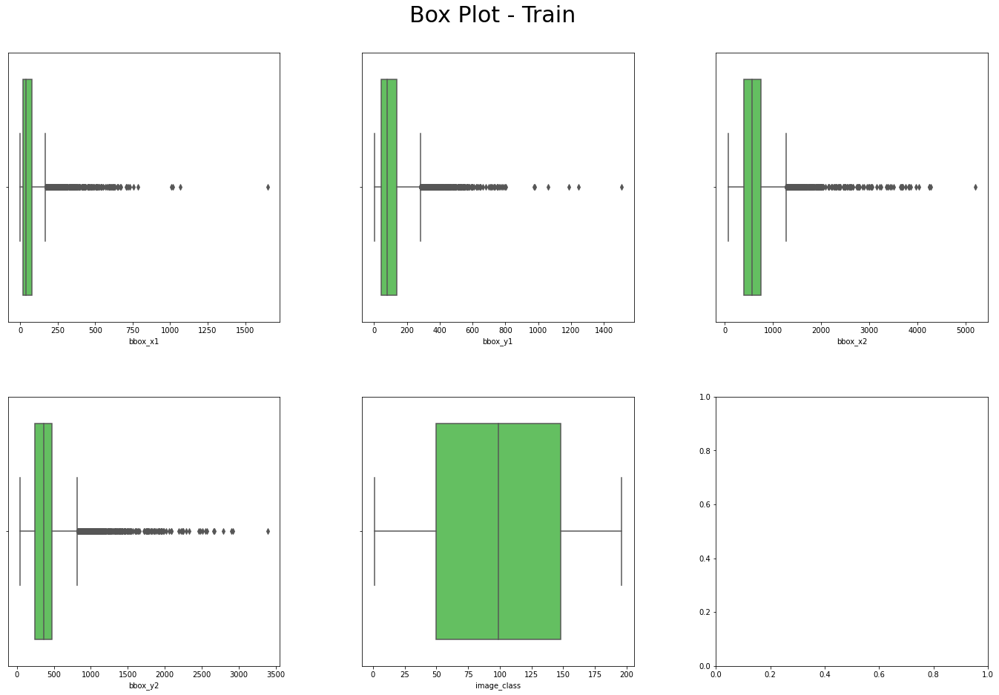

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('Box Plot - Train', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.boxplot(data=train_df, x=col, ax=axes[x_axes,y_axes], color='#55cf51')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

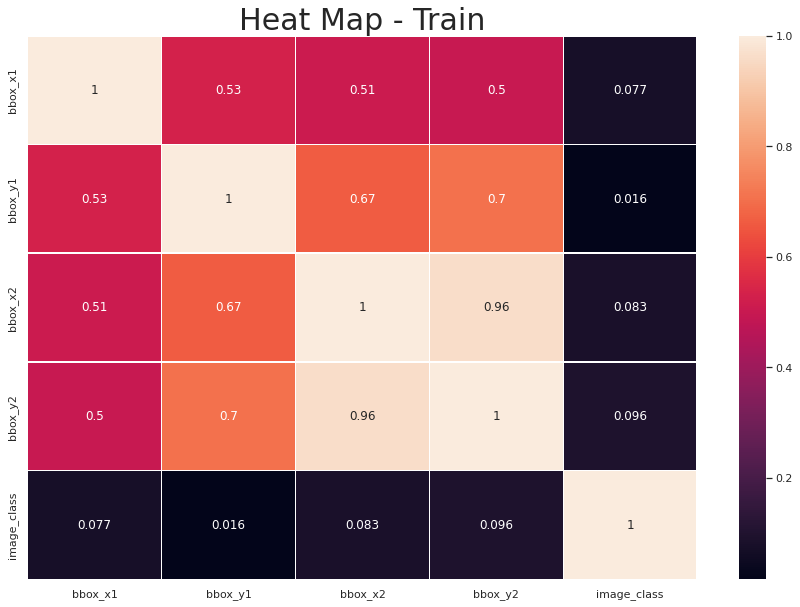

In [ ]:
sns.set(rc={'figure.figsize':(15,10)})
sns.heatmap(train_df.corr(), annot=True, linewidths='.5', color='#4747b5')
plt.title('Heat Map - Train', fontsize=30)
plt.show()

### EDA - Test

In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8041 entries, 0 to 8040
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   image_name   8041 non-null   object
 1   bbox_x1      8041 non-null   int64 
 2   bbox_y1      8041 non-null   int64 
 3   bbox_x2      8041 non-null   int64 
 4   bbox_y2      8041 non-null   int64 
 5   image_class  8041 non-null   int64 
 6   car_make     8041 non-null   object
 7   image_path   8041 non-null   string
dtypes: int64(5), object(2), string(1)
memory usage: 823.4+ KB


In [ ]:
test_df.describe(include='all')

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make,image_path
count,8041,8041.000000,8041.000000,8041.000000,8041.000000,8041.000000,8041,8041
unique,8041,NaN,NaN,NaN,NaN,NaN,196,8041
top,00001.jpg,NaN,NaN,NaN,NaN,NaN,GMC Savana Van 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
freq,1,NaN,NaN,NaN,NaN,NaN,68,1
mean,NaN,65.057456,107.816192,639.433777,417.301828,98.975501,NaN,NaN
std,NaN,82.336438,108.052354,411.632197,274.659479,56.505578,NaN,NaN
min,NaN,1.000000,1.000000,72.000000,41.000000,1.000000,NaN,NaN
25%,NaN,19.000000,40.000000,395.000000,249.000000,51.000000,NaN,NaN
50%,NaN,39.000000,79.000000,575.000000,364.000000,99.000000,NaN,NaN
75%,NaN,78.000000,137.000000,748.000000,478.000000,148.000000,NaN,NaN


In [ ]:
test_df.nunique()

image_name     8041
bbox_x1         422
bbox_y1         530
bbox_x2        1420
bbox_y2        1103
image_class     196
car_make        196
image_path     8041
dtype: int64

In [ ]:
test_df.columns

Index(['image_name', 'bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class',
       'car_make', 'image_path'],
      dtype='object')

In [ ]:
test_df.isnull().values.any()

False

In [ ]:
test_df.isnull().sum() 

image_name     0
bbox_x1        0
bbox_y1        0
bbox_x2        0
bbox_y2        0
image_class    0
car_make       0
image_path     0
dtype: int64

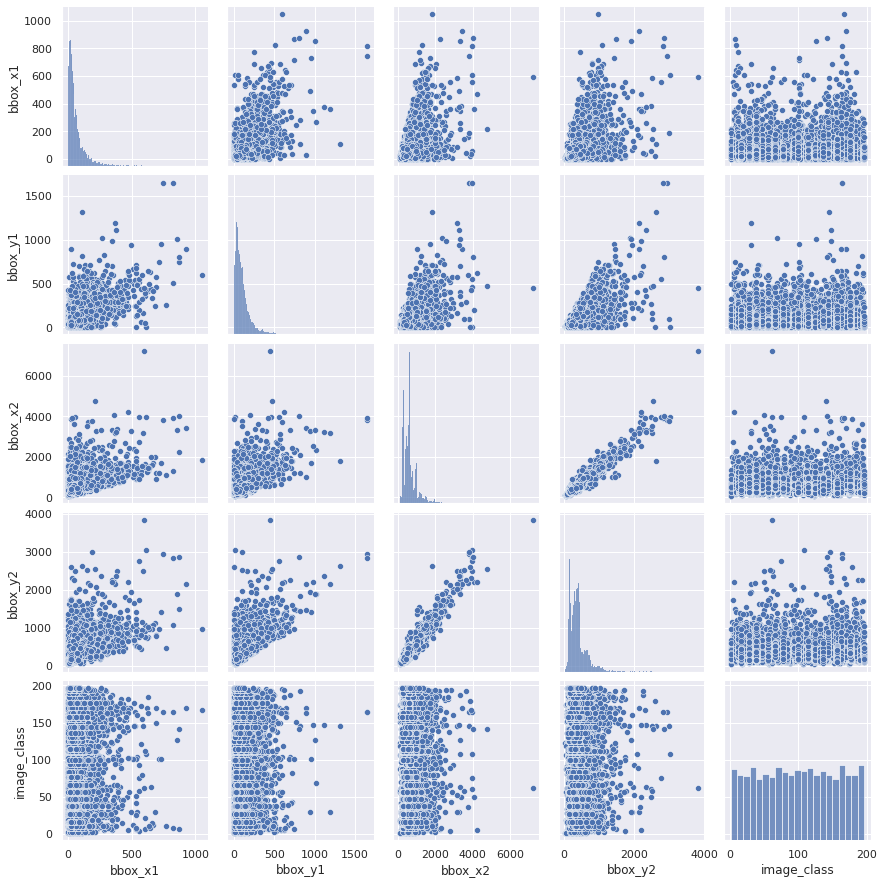

In [ ]:
sns.pairplot(test_df);

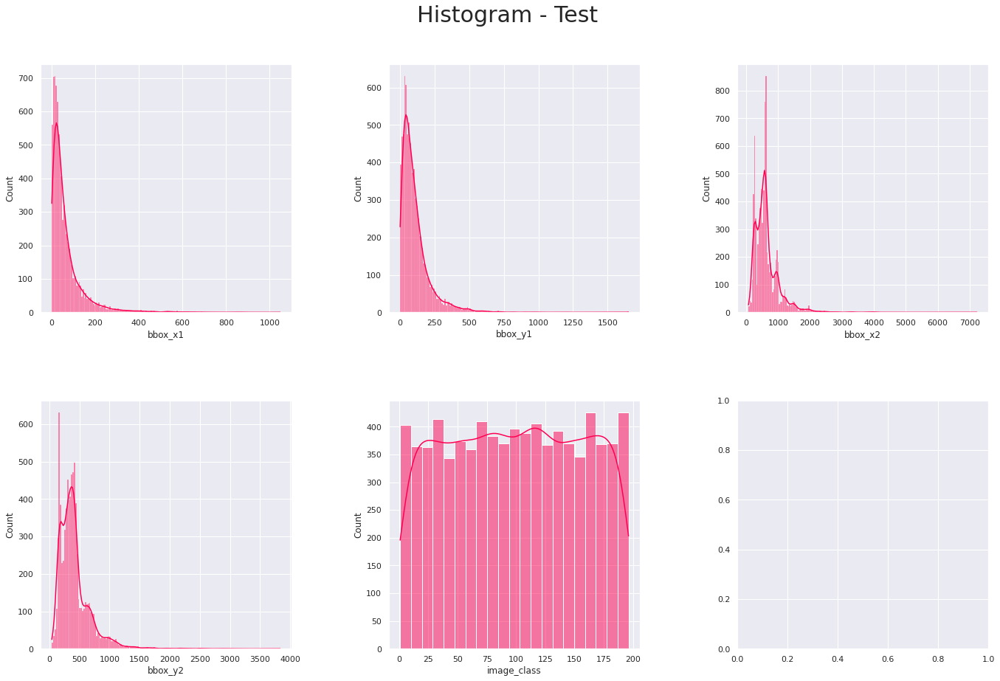

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('Histogram - Test', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.histplot(data=test_df, x=col, kde=True, ax=axes[x_axes,y_axes], color='#ff0051')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

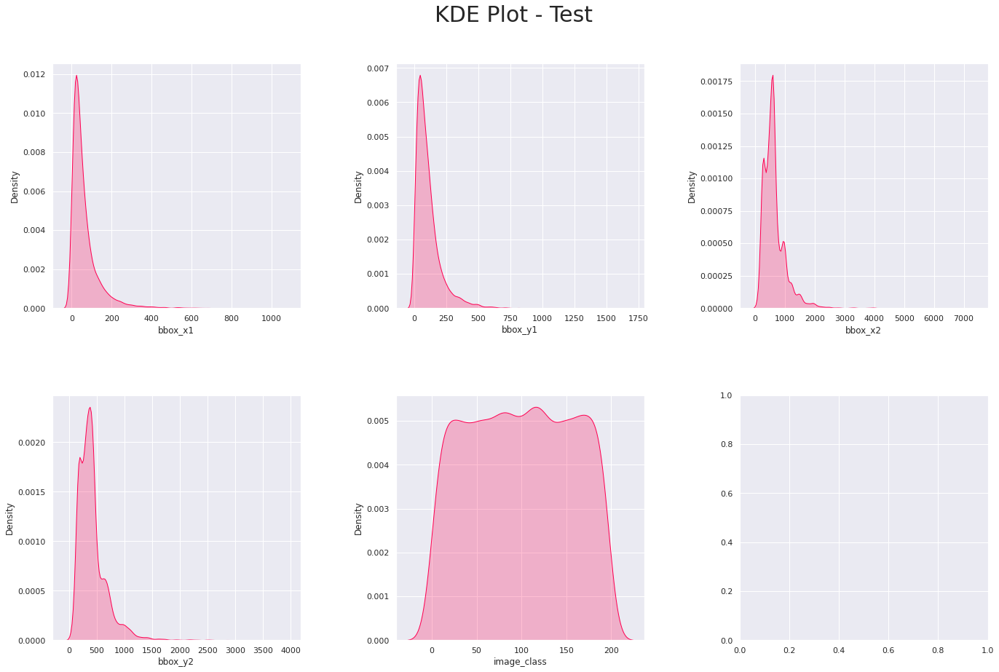

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('KDE Plot - Test', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.kdeplot(data=test_df, x=col, shade=True, ax=axes[x_axes,y_axes], color='#ff0051')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

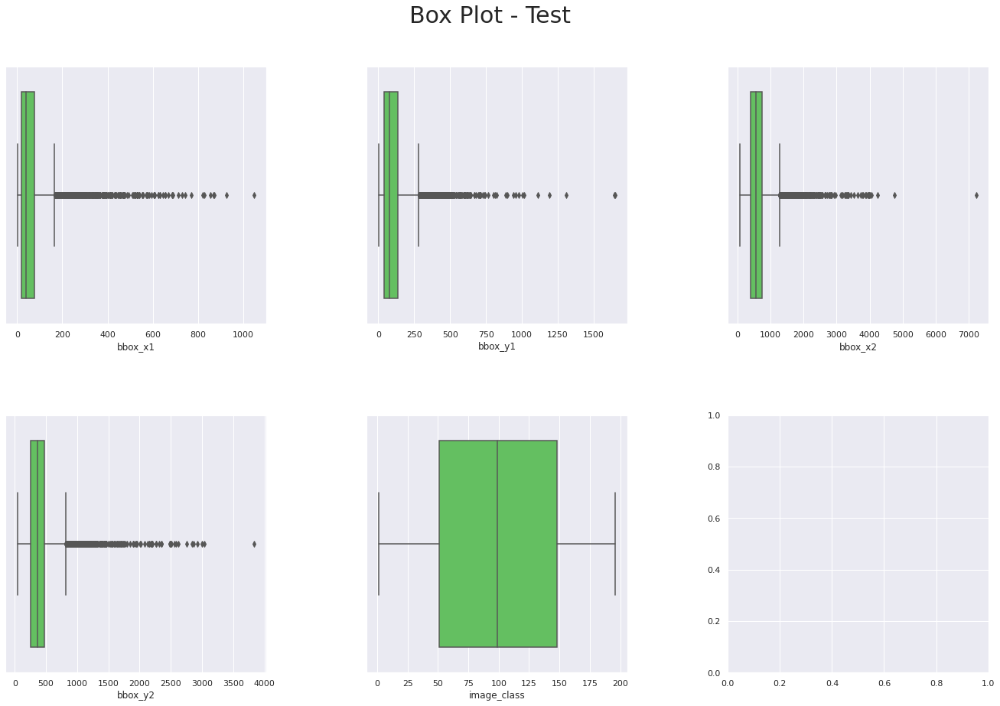

In [ ]:
f,axes=plt.subplots(nrows=2, ncols=3, figsize=(21,14)) 
f.tight_layout(pad=8)
cols=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'image_class']
f.suptitle('Box Plot - Test', fontsize=30)

x_axes=0
y_axes=0

for col in cols:
  sns.boxplot(data=test_df, x=col, ax=axes[x_axes,y_axes], color='#55cf51')

  if y_axes == 2:
    y_axes=0
    x_axes+=1
  else:
    y_axes+=1


plt.show()

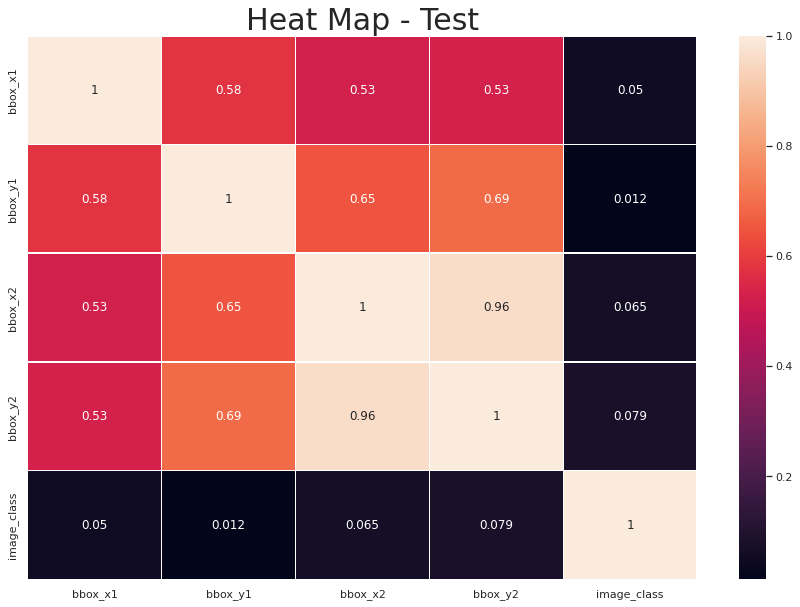

In [ ]:
sns.set(rc={'figure.figsize':(15,10)})
sns.heatmap(test_df.corr(), annot=True, linewidths='.5', color='#4747b5')
plt.title('Heat Map - Test', fontsize=30)
plt.show()

### EDA Observations

We can observe the below aspects when we look into the data,

1. There are 196 classes of cars given in the data set and the same is observed in both the test and training sets.
2. The number of classes in the cars are more or less equally distributed
3. the bounding boxes values follows a similar distribution when we look at x1 and y1 values and again similar distribition with respect to x2 and y2 values
4. We can observe that there are no missing values with the data sets given and that is the case with bopth the test and training datasets.


Step 3: Map training and testing images to its annotations.

In [ ]:
len(train_df)

8144

In [ ]:
train_df.head()

,image_name,bbox_x1,bbox_y1,bbox_x2,bbox_y2,image_class,car_make,image_path
0,00001.jpg,39,116,569,375,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
1,00017.jpg,39,52,233,150,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
2,00411.jpg,52,47,586,260,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
3,00467.jpg,47,92,209,178,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...
4,00888.jpg,7,51,253,156,14,Audi TTS Coupe 2012,/content/drive/MyDrive/ColabNotebooks/Car Imag...


In [ ]:
print('%04d' % (train_df.image_class[0],))

0014


### Cropping the Image to bounding box + margin

In [ ]:
def ensure_folder(folder):
    if not os.path.exists(folder):
        os.makedirs(folder)

In [ ]:
def save_train_data_crop(df):
    num_samples = len(df)

    train_split = 0.8
    num_train = int(round(num_samples * train_split))
    random.seed(42)
    train_indexes = random.sample(range(1, num_samples+1), num_train)

    pb = ProgressBar(total=100, prefix='Save train data', suffix='', decimals=3, length=50, fill='=')

    for i in df.index:
        fname = df.image_name[i]
        label = '%04d' % (df.image_class[i],)
        if i in train_indexes:
            dst_folder = base_path + '/data/train'
        else:
            dst_folder = base_path + '/data/validation'

        dst_path = os.path.join(dst_folder, label)

        if not os.path.exists(os.path.join(dst_path, fname)):
          (x1, y1, x2, y2) = (df.bbox_x1[i],df.bbox_y1[i],df.bbox_x2[i],df.bbox_y2[i])

          src_path = df.image_path[i]
          src_image = cv2.imread(src_path)
          height, width = src_image.shape[:2]
          # margins of 0 pixels
          margin = 0
          x1 = max(0, x1 - margin)
          y1 = max(0, y1 - margin)
          x2 = min(x2 + margin, width)
          y2 = min(y2 + margin, height)
          # print("{} -> {}".format(fname, label))
          pb.print_progress_bar((i + 1) * 100 / num_samples)

          
          ensure_folder(dst_path)
          dst_path = os.path.join(dst_path, fname)

          crop_image = src_image[y1:y2, x1:x2]
          dst_img = cv2.resize(src=crop_image, dsize=(img_height, img_width))
          cv2.imwrite(dst_path, dst_img)

In [ ]:
def save_test_data_crop(df):
    dst_folder = base_path + '/data/test'
    num_samples = len(df)

    pb = ProgressBar(total=100, prefix='Save test data', suffix='', decimals=3, length=50, fill='=')

    for i in df.index:
        fname = df.image_name[i]
        if not os.path.exists(os.path.join(dst_folder, fname)):
          (x1, y1, x2, y2) = (df.bbox_x1[i],df.bbox_y1[i],df.bbox_x2[i],df.bbox_y2[i])
          src_path = df.image_path[i]
          src_image = cv2.imread(src_path)
          height, width = src_image.shape[:2]
          # margins of 0 pixels
          margin = 0
          x1 = max(0, x1 - margin)
          y1 = max(0, y1 - margin)
          x2 = min(x2 + margin, width)
          y2 = min(y2 + margin, height)
          # print(fname)
          pb.print_progress_bar((i + 1) * 100 / num_samples)

          dst_path = os.path.join(dst_folder, fname)
          crop_image = src_image[y1:y2, x1:x2]
          dst_img = cv2.resize(src=crop_image, dsize=(img_height, img_width))
          cv2.imwrite(dst_path, dst_img)

In [ ]:
print('class_names.shape: ' + str(name_make_df.shape))
print(f'Sample class_name: [{name_make_df.car_make}]')

class_names.shape: (196, 2)
Sample class_name: [0            AM General Hummer SUV 2000
1                   Acura RL Sedan 2012
2                   Acura TL Sedan 2012
3                  Acura TL Type-S 2008
4                  Acura TSX Sedan 2012
                     ...               
191    Volkswagen Beetle Hatchback 2012
192            Volvo C30 Hatchback 2012
193                Volvo 240 Sedan 1993
194                 Volvo XC90 SUV 2007
195       smart fortwo Convertible 2012
Name: car_make, Length: 196, dtype: object]


In [ ]:
if __name__ == '__main__':
    # parameters
    img_width, img_height = 500, 500

    ensure_folder(base_path + '/data/train')
    ensure_folder(base_path + '/data/validation')
    
    save_train_data_crop(train_df)

Save train data |==================================================| 100.000% 


In [ ]:
totalFiles = 0
totalDir = 0
for base, dirs, files in os.walk(base_path + '/data/train'):
    for directories in dirs:
        totalDir += 1
    for Files in files:
        totalFiles += 1

print('Total number of files',totalFiles)
print('Total Number of directories',totalDir)

Total number of files 6514
Total Number of directories 196


In [ ]:
totalFiles = 0
totalDir = 0
for base, dirs, files in os.walk(base_path + '/data/validation'):
    for directories in dirs:
        totalDir += 1
    for Files in files:
        totalFiles += 1

print('Total number of files',totalFiles)
print('Total Number of directories',totalDir)

Total number of files 1630
Total Number of directories 196


In [ ]:
if __name__ == '__main__':
    # parameters
    img_width, img_height = 500, 500
    ensure_folder(base_path + '/data/test')

    save_test_data_crop(test_df)

Save test data |==================================================| 100.000% 


In [ ]:
totalFiles = 0
totalDir = 0
for base, dirs, files in os.walk(base_path + '/data/test'):
    for directories in dirs:
        totalDir += 1
    for Files in files:
        totalFiles += 1

print('Total number of files',totalFiles)
print('Total Number of directories',totalDir)

Total number of files 8041
Total Number of directories 0



Step 4: Display images with bounding box.

In [ ]:
def imgshow(df, num_to_show=12, img_per_row=3):
    
    plt.figure(figsize=(20,20))
    df = df.sample(n=num_to_show)
    i = 0
    for ind in df.index:
      plt.subplot(np.ceil(num_to_show/img_per_row), img_per_row, i+1)
      i+=1
      plt.grid(False)
      plt.axis('off')        
      img = load_image(df.image_path[ind])
      plt.imshow(img)
    return df

In [ ]:
def imgshow_with_bboxes(df, img_per_row):
    
    plt.figure(figsize=(20,20))
    i = 0
    for ind in df.index:
      plt.subplot(np.ceil(len(df)/img_per_row), img_per_row, i+1)
      i+=1
      plt.grid(False)
      plt.axis('off')        
      img = load_image(df.image_path[ind])
      image=cv2.rectangle(img,(df.bbox_x1[ind],df.bbox_y1[ind]),(df.bbox_x2[ind],df.bbox_y2[ind]),(0,0,255),2)
      plt.imshow(image)

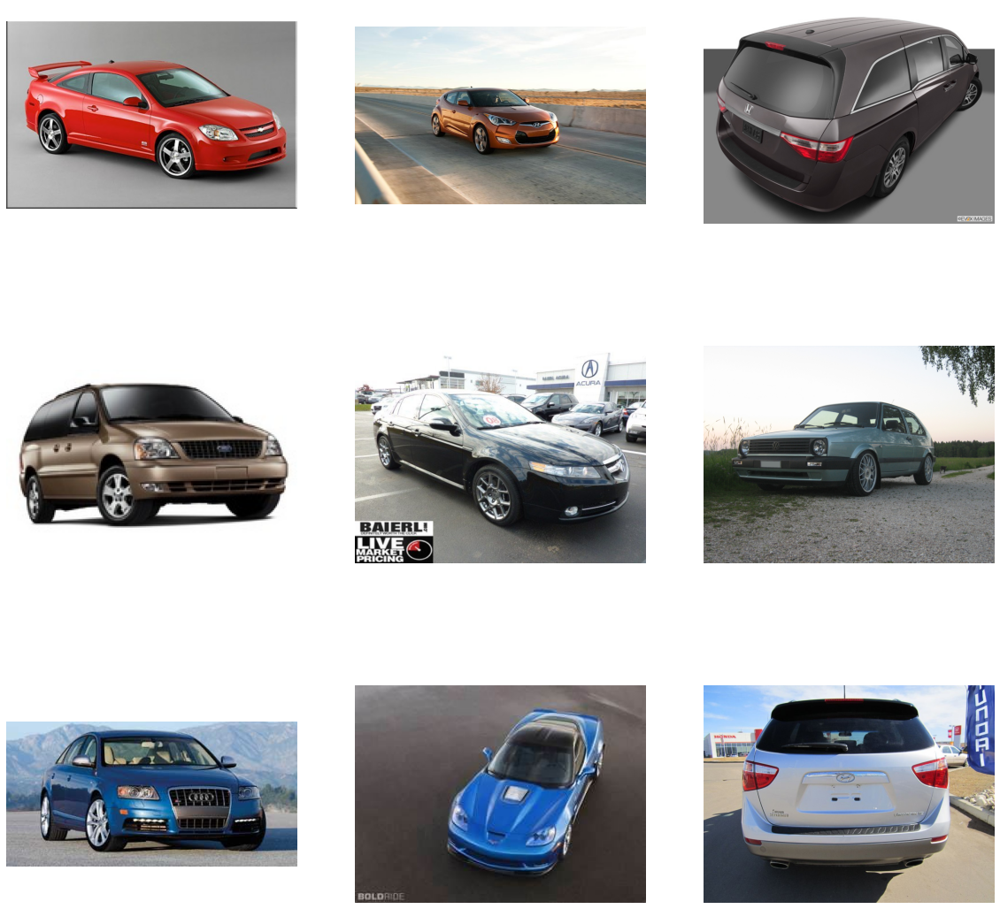

In [ ]:
df = imgshow(train_df, 9, 3)

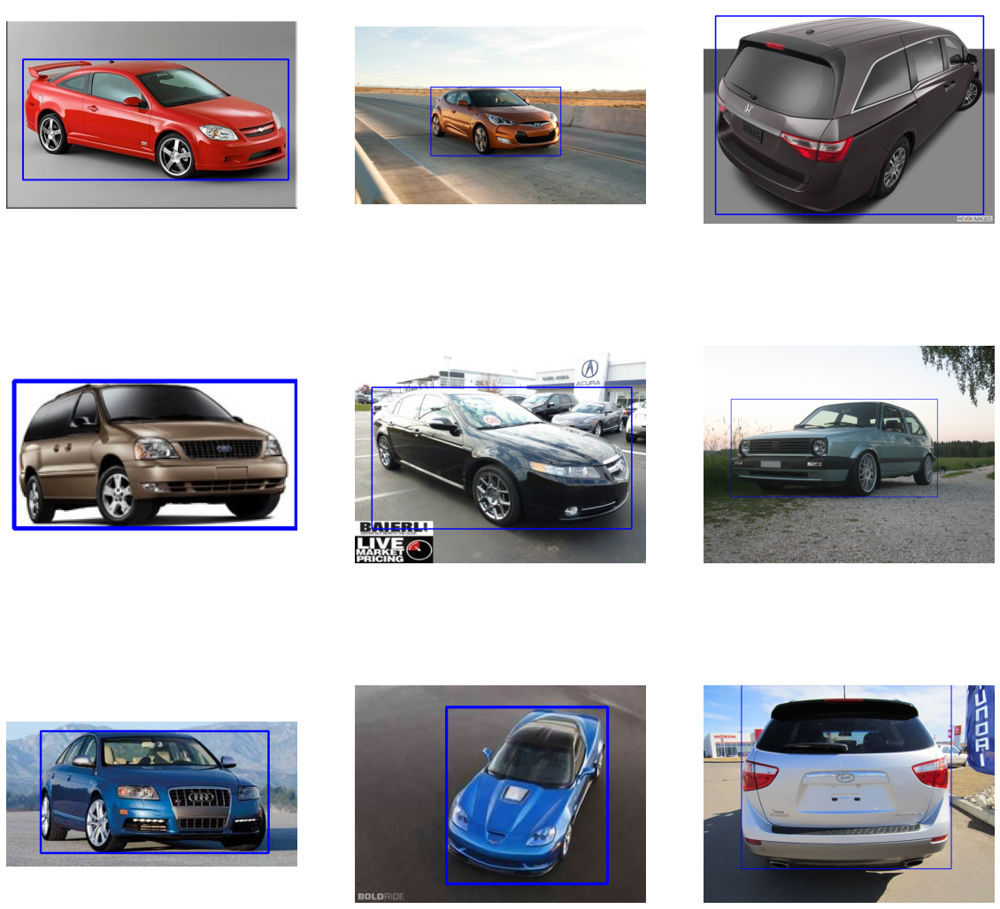

In [ ]:
imgshow_with_bboxes(df, 3)

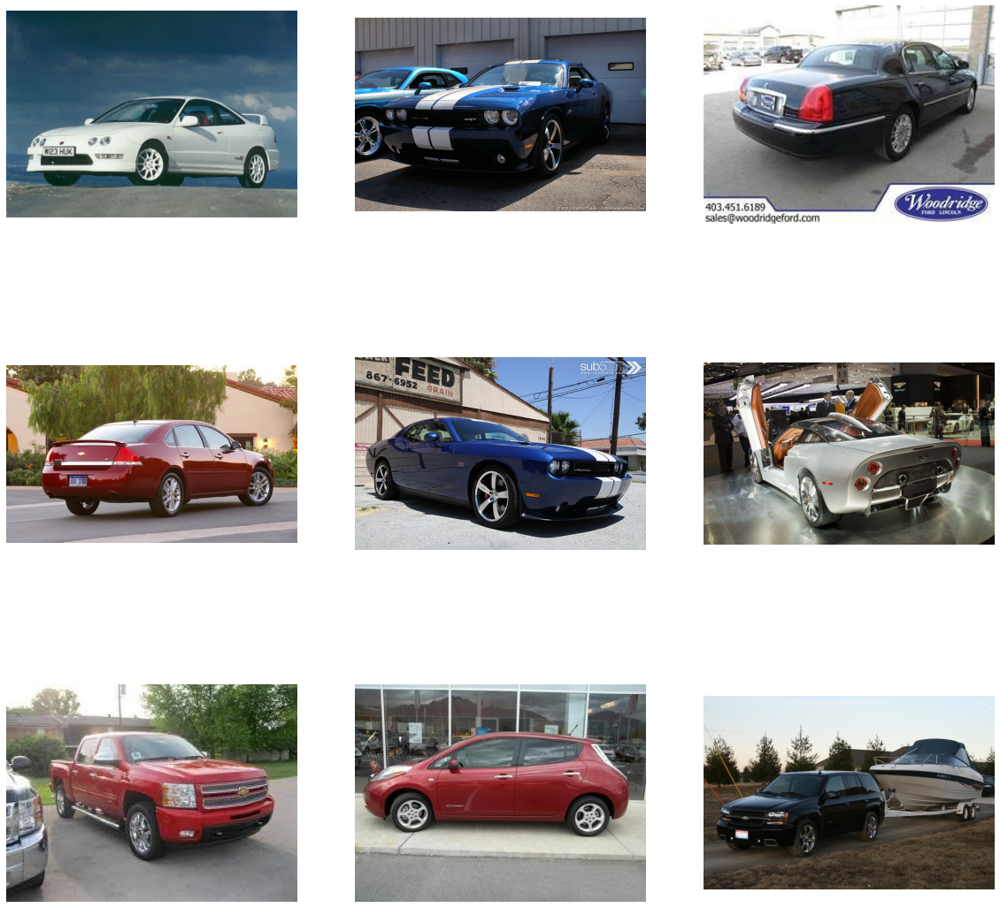

In [ ]:
df = imgshow(test_df, 9, 3)

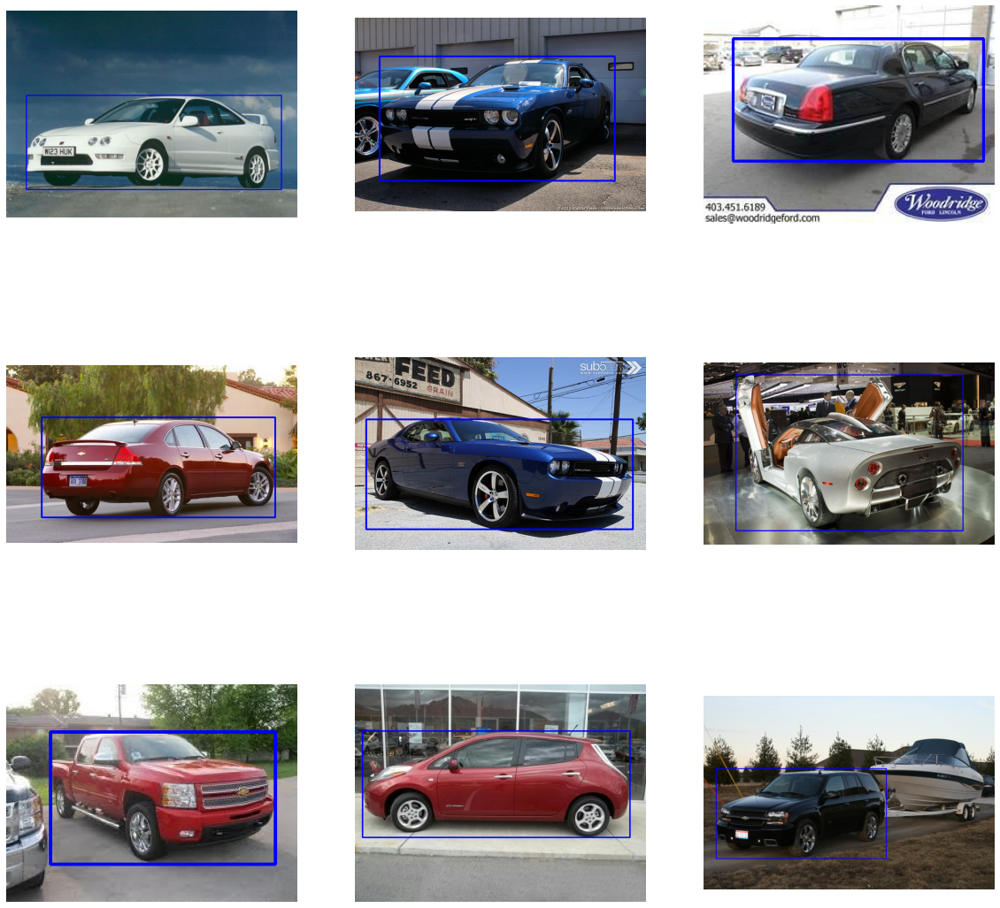

In [ ]:
imgshow_with_bboxes(df, 3)


Step 5: Design, train and test basic CNN models to classify the car.

In [ ]:
def plot_loss_acc(history):
    plt.figure(figsize=(20,7))
    plt.subplot(1,2,1)
    plt.plot(history.history['loss'][1:])    
    plt.plot(history.history['val_loss'][1:])    
    plt.title('model loss')    
    plt.ylabel('val_loss')    
    plt.xlabel('epoch')    
    plt.legend(['Train','Validation'], loc='upper left')
    
    plt.subplot(1,2,2)
    plt.plot(history.history['accuracy'][1:])
    plt.plot(history.history['val_accuracy'][1:])
    plt.title('Model Accuracy')
    plt.ylabel('val_acc')
    plt.xlabel('epoch')
    plt.legend(['Train','Validation'], loc='upper left')
    plt.show()

In [ ]:
class SnapshotCallbackBuilder:
    def __init__(self, nb_epochs, nb_snapshots, init_lr=0.1):
        self.T = nb_epochs
        self.M = nb_snapshots
        self.alpha_zero = init_lr

    def get_callbacks(self, model_prefix='Model'):

        callback_list = [
            swa,
            callbacks.LearningRateScheduler(schedule=self._cosine_anneal_schedule)
        ]

        return callback_list

    def _cosine_anneal_schedule(self, t):
        cos_inner = np.pi * (t % (self.T // self.M))  # t - 1 is used when t has 1-based indexing.
        cos_inner /= self.T // self.M
        cos_out = np.cos(cos_inner) + 1
        return float(self.alpha_zero / 2 * cos_out)

class SWA(keras.callbacks.Callback):
    
    def __init__(self, filepath, swa_epoch):
        super(SWA, self).__init__()
        self.filepath = filepath
        self.swa_epoch = swa_epoch 
    
    def on_train_begin(self, logs=None):
        self.nb_epoch = self.params['epochs']
        print('Stochastic weight averaging selected for last {} epochs.'
              .format(self.nb_epoch - self.swa_epoch))
        
    def on_epoch_end(self, epoch, logs=None):
        
        if epoch == self.swa_epoch:
            self.swa_weights = self.model.get_weights()
            
        elif epoch > self.swa_epoch:    
            for i in range(len(self.swa_weights)):
                self.swa_weights[i] = (self.swa_weights[i] * 
                    (epoch - self.swa_epoch) + self.model.get_weights()[i])/((epoch - self.swa_epoch)  + 1)  

        else:
            pass
        
    def on_train_end(self, logs=None):
        self.model.set_weights(self.swa_weights)
        print('Final model parameters set to stochastic weight average.')
        self.model.save_weights(self.filepath)
        print('Final stochastic averaged weights saved to file.')

In [ ]:
train_datagen = ImageDataGenerator(
        rescale=1./255,
        shear_range=0.2,
        rotation_range=20.,
        width_shift_range=0.1,
        height_shift_range=0.1,
        zoom_range=[0.9, 1.25],
        brightness_range=[0.5, 1.5],
        horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
        base_path + '/data/train',
        target_size=(299, 299),
        batch_size=32,
        class_mode='categorical')

validation_generator = test_datagen.flow_from_directory(
        base_path + '/data/validation',
        target_size=(299, 299),
        batch_size=32,
        class_mode='categorical')

Found 6514 images belonging to 196 classes.
Found 1630 images belonging to 196 classes.


In [ ]:
def build_finetune_model(base_model, dropout, num_classes):

    x = base_model.output
    x = Flatten()(x)
    predictions = Dense(num_classes, activation='softmax', name='finalfc')(x)
    
    finetune_model = Model(inputs=base_model.input, outputs=predictions)

    return finetune_model

In [ ]:
HEIGHT = 299
WIDTH = 299
input_shape=(HEIGHT, WIDTH, 3)

dropout = 0.5

# Basic CNN Model

In [ ]:
def create_downsample(channels, inputs, momentum, dropout):
    x = keras.layers.BatchNormalization(momentum=momentum)(inputs)
    x = keras.layers.LeakyReLU(0)(x)
    x = keras.layers.Conv2D(channels, 1, padding='same', use_bias=False)(x)
    x = keras.layers.MaxPool2D(2)(x)
    x = Dropout(dropout)(x)
    return x


def create_resblock(channels, inputs, momentum, dropout):
    x = keras.layers.BatchNormalization(momentum=momentum)(inputs)
    x = keras.layers.LeakyReLU(0)(x)
    x = keras.layers.Conv2D(channels, 3, padding='same', use_bias=False)(x)
    x = keras.layers.BatchNormalization(momentum=momentum)(x)
    x = keras.layers.LeakyReLU(0)(x)
    x = keras.layers.Conv2D(channels, 3, padding='same', use_bias=False)(x)
    x = Dropout(dropout)(x)

    #Added Start
    x = keras.layers.BatchNormalization(momentum=momentum)(x)
    x = keras.layers.LeakyReLU(0)(x)
    x = keras.layers.Conv2D(channels, 3, padding='same', use_bias=False)(x)
    x = Dropout(dropout)(x)
    #Added End
    
    addInput = x;
    print("Add input shape:", addInput.shape)
    print("Resnet block input shape:", inputs.shape)
    resBlockOut = keras.layers.add([addInput, inputs])
    print("Resnet block out shape:", resBlockOut.shape)
    out = keras.layers.concatenate([resBlockOut, addInput], axis=3)
    print("concat block out shape:", out.shape)
    out = keras.layers.Conv2D(channels, 1, padding='same', use_bias=False)(out)
    print("mixed block out shape:", out.shape)
    return out

def create_network(input_shape, channels, n_blocks=2, depth=4, momentum=0.5, dropout=0.5):
    # input
    inputs = keras.Input(shape=(input_shape))
    x = keras.layers.Conv2D(channels, 3, padding='same', use_bias=False)(inputs)
    # residual blocks
    for d in range(depth):
        channels = channels * 2
        x = create_downsample(channels, x, momentum, dropout)
        for b in range(n_blocks):
            x = create_resblock(channels, x, momentum, dropout)
    # output
    x = keras.layers.BatchNormalization(momentum=momentum)(x)
    x = keras.layers.LeakyReLU(0)(x)
    x = keras.layers.Conv2D(1, 1, activation='sigmoid')(x)
    outputs = keras.layers.UpSampling2D(2**depth)(x)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model

In [ ]:
epochs = 10
swa = SWA('./keras_swa.model',epochs-5)
base_model = create_network(input_shape=input_shape, channels=16, n_blocks=2, depth=3, momentum=0.9, dropout=dropout)
finetune_model = build_finetune_model(base_model, 
                                      dropout=dropout, 
                                      num_classes=196)
finetune_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
finetune_model.summary()

Add input shape: (None, 149, 149, 32)
Resnet block input shape: (None, 149, 149, 32)
Resnet block out shape: (None, 149, 149, 32)
concat block out shape: (None, 149, 149, 64)
mixed block out shape: (None, 149, 149, 32)
Add input shape: (None, 149, 149, 32)
Resnet block input shape: (None, 149, 149, 32)
Resnet block out shape: (None, 149, 149, 32)
concat block out shape: (None, 149, 149, 64)
mixed block out shape: (None, 149, 149, 32)
Add input shape: (None, 74, 74, 64)
Resnet block input shape: (None, 74, 74, 64)
Resnet block out shape: (None, 74, 74, 64)
concat block out shape: (None, 74, 74, 128)
mixed block out shape: (None, 74, 74, 64)
Add input shape: (None, 74, 74, 64)
Resnet block input shape: (None, 74, 74, 64)
Resnet block out shape: (None, 74, 74, 64)
concat block out shape: (None, 74, 74, 128)
mixed block out shape: (None, 74, 74, 64)
Add input shape: (None, 37, 37, 128)
Resnet block input shape: (None, 37, 37, 128)
Resnet block out shape: (None, 37, 37, 128)
concat block ou

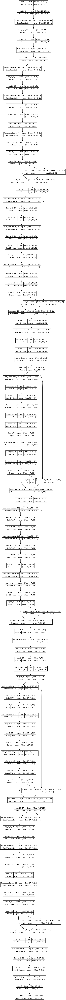

In [ ]:
tf.keras.utils.plot_model(
    finetune_model,
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
)

In [ ]:
snapshot = SnapshotCallbackBuilder(nb_epochs=epochs,nb_snapshots=1,init_lr=1e-3)

history = finetune_model.fit_generator(generator=train_generator,
                                        validation_data=validation_generator,
                                        steps_per_epoch=150,
                                        epochs=epochs,verbose=2,validation_steps=30,callbacks=snapshot.get_callbacks())

try:
    finetune_model.load_weights('./keras_swa.model')
except Exception as e:
    print(e)

Stochastic weight averaging selected for last 5 epochs.
Epoch 1/10
150/150 - 172s - loss: 20.0810 - accuracy: 0.0031 - val_loss: 5.7514 - val_accuracy: 0.0031 - lr: 0.0010 - 172s/epoch - 1s/step
Epoch 2/10
150/150 - 165s - loss: 5.4011 - accuracy: 0.0069 - val_loss: 5.2995 - val_accuracy: 0.0083 - lr: 9.7553e-04 - 165s/epoch - 1s/step
Epoch 3/10
150/150 - 163s - loss: 5.2963 - accuracy: 0.0056 - val_loss: 5.2794 - val_accuracy: 0.0042 - lr: 9.0451e-04 - 163s/epoch - 1s/step
Epoch 4/10
150/150 - 163s - loss: 5.2741 - accuracy: 0.0071 - val_loss: 5.2787 - val_accuracy: 0.0031 - lr: 7.9389e-04 - 163s/epoch - 1s/step
Epoch 5/10
150/150 - 163s - loss: 5.2549 - accuracy: 0.0098 - val_loss: 5.2766 - val_accuracy: 0.0094 - lr: 6.5451e-04 - 163s/epoch - 1s/step
Epoch 6/10
150/150 - 163s - loss: 5.2284 - accuracy: 0.0100 - val_loss: 5.2752 - val_accuracy: 0.0042 - lr: 5.0000e-04 - 163s/epoch - 1s/step
Epoch 7/10
150/150 - 170s - loss: 5.2060 - accuracy: 0.0119 - val_loss: 5.2766 - val_accuracy: 

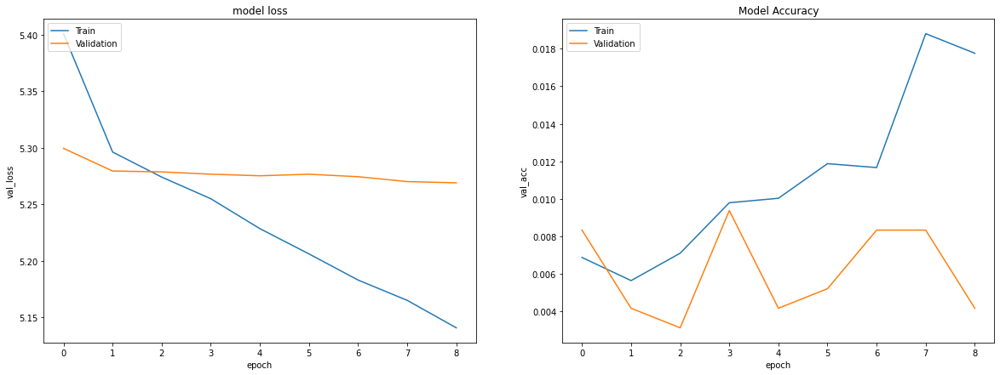

In [ ]:
plot_loss_acc(history)

### EfficientNetB3

In [ ]:
epochs = 5
swa = SWA('./keras_swa_en.model',epochs-5)

base_model_en = EfficientNetB3(weights='imagenet',
                            include_top=False,
                            input_shape=input_shape)

finetune_model_en = build_finetune_model(base_model_en, 
                                      dropout=dropout, 
                                      num_classes=196)

finetune_model_en.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
finetune_model_en.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 stem_conv (Conv2D)             (None, 150, 150, 40  1080        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 stem_bn (BatchNormalization)   (None, 150, 150, 40  160         ['stem_conv[0][0]']              
                                )                                                           

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.781935 to fit



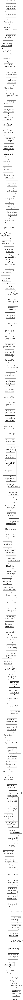

In [ ]:
tf.keras.utils.plot_model(
    finetune_model_en,
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
)

In [ ]:
snapshot_en = SnapshotCallbackBuilder(nb_epochs=epochs,nb_snapshots=1,init_lr=1e-3)

history_en = finetune_model_en.fit_generator(generator=train_generator,
                                        validation_data=validation_generator,
                                        steps_per_epoch=150,
                                        epochs=epochs,verbose=2,validation_steps=30,callbacks=snapshot_en.get_callbacks())

try:
    finetune_model_en.load_weights('./keras_swa_en.model')
except Exception as e:
    print(e)

Stochastic weight averaging selected for last 5 epochs.
Epoch 1/5
150/150 - 266s - loss: 12.9291 - accuracy: 0.0529 - val_loss: 13.1696 - val_accuracy: 0.0427 - lr: 0.0010 - 266s/epoch - 2s/step
Epoch 2/5
150/150 - 303s - loss: 8.8863 - accuracy: 0.2259 - val_loss: 10.3153 - val_accuracy: 0.2552 - lr: 9.0451e-04 - 303s/epoch - 2s/step
Epoch 3/5
150/150 - 294s - loss: 5.5069 - accuracy: 0.4461 - val_loss: 6.3785 - val_accuracy: 0.4740 - lr: 6.5451e-04 - 294s/epoch - 2s/step
Epoch 4/5
150/150 - 293s - loss: 2.6789 - accuracy: 0.6550 - val_loss: 3.2466 - val_accuracy: 0.6313 - lr: 3.4549e-04 - 293s/epoch - 2s/step
Epoch 5/5
150/150 - 294s - loss: 1.2367 - accuracy: 0.7944 - val_loss: 2.3605 - val_accuracy: 0.6958 - lr: 9.5492e-05 - 294s/epoch - 2s/step
Final model parameters set to stochastic weight average.
Final stochastic averaged weights saved to file.


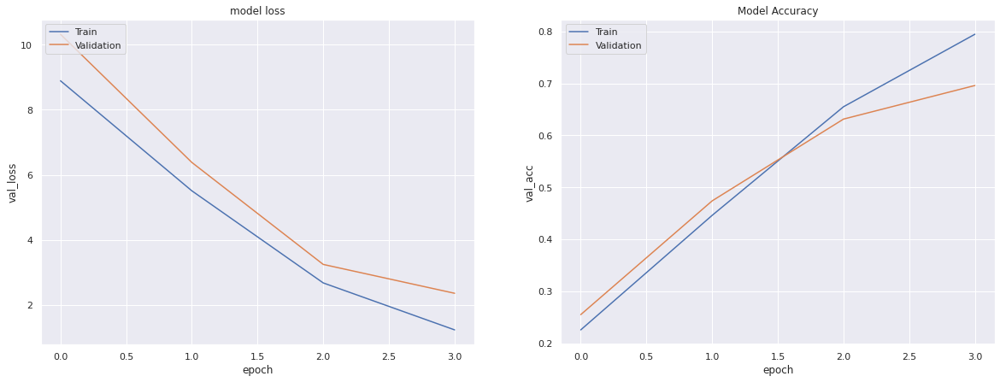

In [ ]:
plot_loss_acc(history_en)

### DenseNet121

In [ ]:
weight_path = os.path.join(base_path, 'densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5')
print(weight_path)

/content/drive/MyDrive/ColabNotebooks/densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5


In [ ]:
epochs = 10
swa = SWA('./keras_swa_dn.model',epochs-5)

base_model_dn = densenet.DenseNet121(input_shape=input_shape,
                                     weights='/content/drive/MyDrive/ColabNotebooks/densenet121_weights_tf_dim_ordering_tf_kernels_notop.h5',
                                     include_top=False,
                                     pooling='avg')

finetune_model_dn = build_finetune_model(base_model_dn, 
                                      dropout=dropout, 
                                      num_classes=196)

finetune_model_dn.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
finetune_model_dn.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 305, 305, 3)  0          ['input_3[0][0]']                
                                                                                                  
 conv1/conv (Conv2D)            (None, 150, 150, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                            

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.689121 to fit



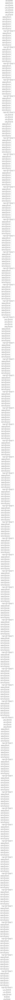

In [ ]:
tf.keras.utils.plot_model(
    finetune_model_dn,
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
)

In [ ]:
snapshot_dn = SnapshotCallbackBuilder(nb_epochs=epochs,nb_snapshots=1,init_lr=1e-3)

history_dn = finetune_model_dn.fit_generator(generator=train_generator,
                                        validation_data=validation_generator,
                                        steps_per_epoch=150,
                                        epochs=epochs,verbose=2,validation_steps=30,callbacks=snapshot_dn.get_callbacks())

try:
    finetune_model_dn.load_weights('./keras_swa_dn.model')
except Exception as e:
    print(e)

Stochastic weight averaging selected for last 5 epochs.
Epoch 1/10
150/150 - 198s - loss: 5.5409 - accuracy: 0.0069 - val_loss: 1701.1421 - val_accuracy: 0.0031 - lr: 0.0010 - 198s/epoch - 1s/step
Epoch 2/10
150/150 - 171s - loss: 5.3613 - accuracy: 0.0102 - val_loss: 131.0865 - val_accuracy: 0.0073 - lr: 9.7553e-04 - 171s/epoch - 1s/step
Epoch 3/10
150/150 - 174s - loss: 5.2074 - accuracy: 0.0162 - val_loss: 5.5066 - val_accuracy: 0.0094 - lr: 9.0451e-04 - 174s/epoch - 1s/step
Epoch 4/10
150/150 - 178s - loss: 5.0659 - accuracy: 0.0198 - val_loss: 5.2174 - val_accuracy: 0.0177 - lr: 7.9389e-04 - 178s/epoch - 1s/step
Epoch 5/10
150/150 - 175s - loss: 4.9618 - accuracy: 0.0274 - val_loss: 9.8274 - val_accuracy: 0.0188 - lr: 6.5451e-04 - 175s/epoch - 1s/step
Epoch 6/10
150/150 - 173s - loss: 4.8452 - accuracy: 0.0357 - val_loss: 5.0419 - val_accuracy: 0.0302 - lr: 5.0000e-04 - 173s/epoch - 1s/step
Epoch 7/10
150/150 - 268s - loss: 4.6395 - accuracy: 0.0525 - val_loss: 4.7946 - val_accura

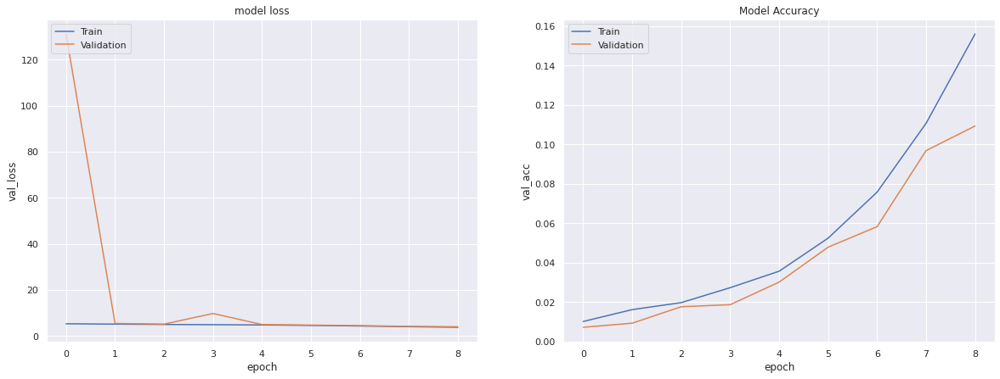

In [ ]:
plot_loss_acc(history_dn)

### InceptionResNetV2

In [ ]:
epochs = 10
swa = SWA('./keras_swa_ir.model',epochs-5)

base_model_ir = InceptionResNetV2(weights="imagenet",include_top=False, input_tensor=Input(input_shape))

finetune_model_ir = build_finetune_model(base_model_ir, 
                                      dropout=dropout, 
                                      num_classes=196)

finetune_model_ir.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
finetune_model_ir.summary()

219055592/219055592 [==============================] - 10s 0us/step
Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 149, 149, 32  864         ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 149, 149, 32  96         ['conv2d[0][0]']                 
 alization)             

In [ ]:
tf.keras.utils.plot_model(
    finetune_model_ir,
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.517941 to fit



In [ ]:
snapshot_ir = SnapshotCallbackBuilder(nb_epochs=epochs,nb_snapshots=1,init_lr=1e-3)

history_ir = finetune_model_ir.fit_generator(generator=train_generator,
                                        validation_data=validation_generator,
                                        steps_per_epoch=150,
                                        epochs=epochs,verbose=2,validation_steps=30,callbacks=snapshot_ir.get_callbacks())

try:
    finetune_model_ir.load_weights('./keras_swa_ir.model')
except Exception as e:
    print(e)

Stochastic weight averaging selected for last 5 epochs.
Epoch 1/10
150/150 - 228s - loss: 6.1733 - accuracy: 0.0048 - val_loss: 5.5639 - val_accuracy: 0.0021 - lr: 0.0010 - 228s/epoch - 2s/step
Epoch 2/10
150/150 - 205s - loss: 5.3740 - accuracy: 0.0096 - val_loss: 28.7063 - val_accuracy: 0.0010 - lr: 9.7553e-04 - 205s/epoch - 1s/step
Epoch 3/10
150/150 - 200s - loss: 5.3798 - accuracy: 0.0113 - val_loss: 5.3680 - val_accuracy: 0.0146 - lr: 9.0451e-04 - 200s/epoch - 1s/step
Epoch 4/10
150/150 - 197s - loss: 5.2756 - accuracy: 0.0225 - val_loss: 5.6364 - val_accuracy: 0.0385 - lr: 7.9389e-04 - 197s/epoch - 1s/step
Epoch 5/10
150/150 - 197s - loss: 4.8399 - accuracy: 0.0543 - val_loss: 4.9399 - val_accuracy: 0.0562 - lr: 6.5451e-04 - 197s/epoch - 1s/step
Epoch 6/10
150/150 - 199s - loss: 4.3839 - accuracy: 0.1049 - val_loss: 4.4565 - val_accuracy: 0.0958 - lr: 5.0000e-04 - 199s/epoch - 1s/step
Epoch 7/10
150/150 - 508s - loss: 3.8758 - accuracy: 0.1626 - val_loss: 3.9483 - val_accuracy: 

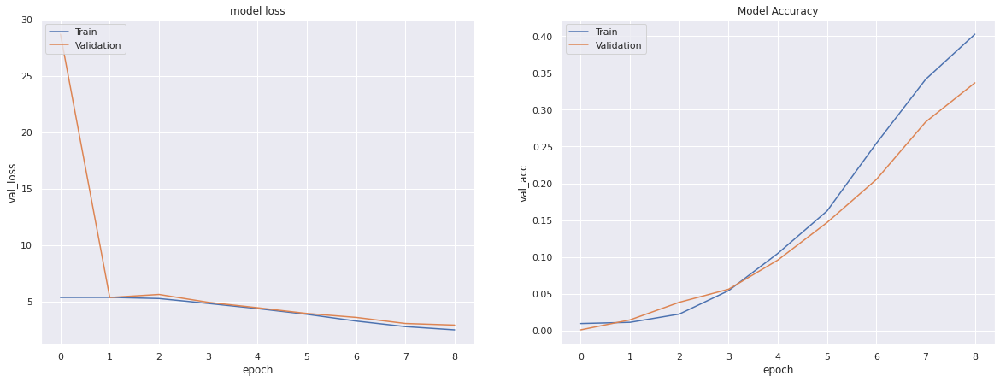

In [ ]:
plot_loss_acc(history_ir)

### MobileNet

In [ ]:
epochs = 10
swa = SWA('./keras_swa_mn.model',epochs-5)

base_model_mn = MobileNet(input_shape=input_shape, include_top=False, alpha=1, weights="imagenet")

finetune_model_mn = build_finetune_model(base_model_mn, 
                                      dropout=dropout, 
                                      num_classes=196)

finetune_model_mn.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
finetune_model_mn.summary()

17225924/17225924 [==============================] - 2s 0us/step
Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 150, 150, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 150, 150, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 150, 150, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 150, 150, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 150, 150, 32)     128  

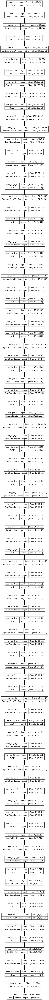

In [ ]:
tf.keras.utils.plot_model(
    finetune_model_mn,
    show_shapes=True,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True,
)

In [ ]:
snapshot_mn = SnapshotCallbackBuilder(nb_epochs=epochs,nb_snapshots=1,init_lr=1e-3)

history_mn = finetune_model_mn.fit_generator(generator=train_generator,
                                        validation_data=validation_generator,
                                        steps_per_epoch=150,
                                        epochs=epochs,verbose=2,validation_steps=30,callbacks=snapshot_mn.get_callbacks())

try:
    finetune_model_mn.load_weights('./keras_swa_mn.model')
except Exception as e:
    print(e)

Stochastic weight averaging selected for last 5 epochs.
Epoch 1/10
150/150 - 162s - loss: 8.1585 - accuracy: 0.0113 - val_loss: 29.5550 - val_accuracy: 0.0063 - lr: 0.0010 - 162s/epoch - 1s/step
Epoch 2/10
150/150 - 157s - loss: 5.0195 - accuracy: 0.0238 - val_loss: 9.3039 - val_accuracy: 0.0188 - lr: 9.7553e-04 - 157s/epoch - 1s/step
Epoch 3/10
150/150 - 154s - loss: 4.5015 - accuracy: 0.0541 - val_loss: 12.4238 - val_accuracy: 0.0125 - lr: 9.0451e-04 - 154s/epoch - 1s/step
Epoch 4/10
150/150 - 153s - loss: 4.0336 - accuracy: 0.1032 - val_loss: 5.3473 - val_accuracy: 0.0760 - lr: 7.9389e-04 - 153s/epoch - 1s/step
Epoch 5/10
150/150 - 155s - loss: 3.5113 - accuracy: 0.1698 - val_loss: 4.2036 - val_accuracy: 0.1312 - lr: 6.5451e-04 - 155s/epoch - 1s/step
Epoch 6/10
150/150 - 155s - loss: 3.0099 - accuracy: 0.2490 - val_loss: 3.5088 - val_accuracy: 0.2094 - lr: 5.0000e-04 - 155s/epoch - 1s/step
Epoch 7/10
150/150 - 165s - loss: 2.4791 - accuracy: 0.3539 - val_loss: 3.0747 - val_accuracy:

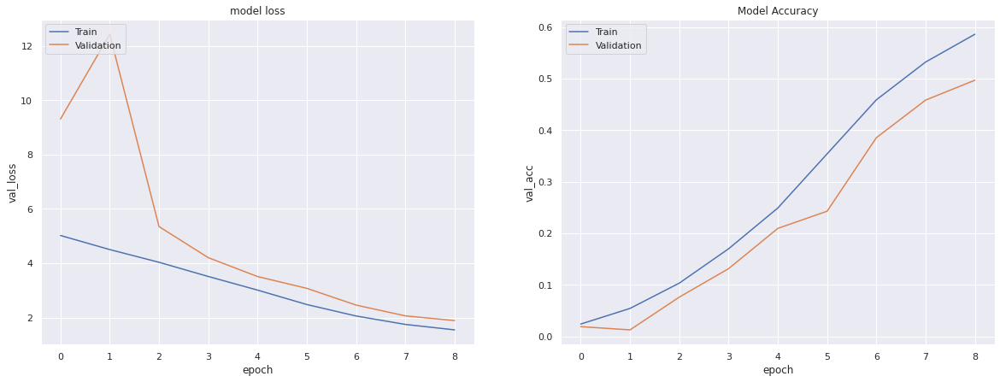

In [ ]:
plot_loss_acc(history_mn)

### Test Results

In [ ]:
path = base_path + '/data/test'
num_samples,all_preds = len(test_df),{}

In [ ]:
for i in tqdm_notebook(range(num_samples)):
    fname = '%05d.jpg' % (i + 1)
    filename = os.path.join(path, '%05d.jpg' % (i + 1))
    bgr_img = cv2.imread(filename)
    rgb_img = cv2.resize(cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)/255,(299,299))
    rgb_img = np.expand_dims(rgb_img, 0)
    preds = finetune_model.predict(rgb_img)
    class_id = np.argmax(preds)
    all_preds[fname] = class_id + 1

  0%|          | 0/8041 [00:00<?, ?it/s]

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 17ms/step


In [ ]:
all_preds_df = pd.DataFrame(all_preds.items(), columns=['fname', 'predicted_class'])
comp_df = pd.merge(all_preds_df, test_df, how="inner", left_on = 'fname', right_on = 'image_name').drop(columns=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'car_make', 'image_path'])
comp_df['match'] = comp_df["predicted_class"] == comp_df["image_class"]
comp_df

,fname,predicted_class,image_name,image_class,match
0,00001.jpg,1,00001.jpg,181,False
1,00002.jpg,1,00002.jpg,103,False
2,00003.jpg,1,00003.jpg,145,False
3,00004.jpg,177,00004.jpg,187,False
4,00005.jpg,1,00005.jpg,185,False
...,...,...,...,...,...
8036,08037.jpg,177,08037.jpg,63,False
8037,08038.jpg,1,08038.jpg,16,False
8038,08039.jpg,1,08039.jpg,17,False
8039,08040.jpg,1,08040.jpg,38,False


In [ ]:
print('Base CNN Model Accuracy = ',(comp_df.match).sum()/len(comp_df)*100)

Base CNN Model Accuracy =  0.8829747543837831


In [ ]:
all_preds_en, all_preds_dn, all_preds_ir, all_preds_mn = {}, {}, {}, {}

In [ ]:
for i in tqdm_notebook(range(num_samples)):
    fname = '%05d.jpg' % (i + 1)
    filename = os.path.join(path, '%05d.jpg' % (i + 1))
    bgr_img = cv2.imread(filename)
    rgb_img = cv2.resize(cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)/255,(299,299))
    rgb_img = np.expand_dims(rgb_img, 0)
    
    preds_en = finetune_model_en.predict(rgb_img)
    class_id_en = np.argmax(preds_en)
    all_preds_en[fname] = class_id_en + 1

    preds_dn = finetune_model_dn.predict(rgb_img)
    class_id_dn = np.argmax(preds_dn)
    all_preds_dn[fname] = class_id_dn + 1

    preds_ir = finetune_model_ir.predict(rgb_img)
    class_id_ir = np.argmax(preds_ir)
    all_preds_ir[fname] = class_id_ir + 1

    preds_mn = finetune_model_mn.predict(rgb_img)
    class_id_mn = np.argmax(preds_mn)
    all_preds_mn[fname] = class_id_mn + 1

  0%|          | 0/8041 [00:00<?, ?it/s]

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 22ms/step


In [ ]:
all_preds_en_df = pd.DataFrame(all_preds_en.items(), columns=['fname', 'predicted_class'])
comp_en_df = pd.merge(all_preds_en_df, test_df, how="inner", left_on = 'fname', right_on = 'image_name').drop(columns=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'car_make', 'image_path'])
comp_en_df['match'] = comp_en_df["predicted_class"] == comp_en_df["image_class"]
comp_en_df

,fname,predicted_class,image_name,image_class,match
0,00001.jpg,83,00001.jpg,181,False
1,00002.jpg,103,00002.jpg,103,True
2,00003.jpg,145,00003.jpg,145,True
3,00004.jpg,187,00004.jpg,187,True
4,00005.jpg,185,00005.jpg,185,True
...,...,...,...,...,...
8036,08037.jpg,63,08037.jpg,63,True
8037,08038.jpg,18,08038.jpg,16,False
8038,08039.jpg,18,08039.jpg,17,False
8039,08040.jpg,36,08040.jpg,38,False


In [ ]:
all_preds_dn_df = pd.DataFrame(all_preds_dn.items(), columns=['fname', 'predicted_class'])
comp_dn_df = pd.merge(all_preds_dn_df, test_df, how="inner", left_on = 'fname', right_on = 'image_name').drop(columns=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'car_make', 'image_path'])
comp_dn_df['match'] = comp_dn_df["predicted_class"] == comp_dn_df["image_class"]
comp_dn_df

,fname,predicted_class,image_name,image_class,match
0,00001.jpg,67,00001.jpg,181,False
1,00002.jpg,103,00002.jpg,103,True
2,00003.jpg,40,00003.jpg,145,False
3,00004.jpg,168,00004.jpg,187,False
4,00005.jpg,150,00005.jpg,185,False
...,...,...,...,...,...
8036,08037.jpg,170,08037.jpg,63,False
8037,08038.jpg,89,08038.jpg,16,False
8038,08039.jpg,33,08039.jpg,17,False
8039,08040.jpg,93,08040.jpg,38,False


In [ ]:
all_preds_ir_df = pd.DataFrame(all_preds_ir.items(), columns=['fname', 'predicted_class'])
comp_ir_df = pd.merge(all_preds_ir_df, test_df, how="inner", left_on = 'fname', right_on = 'image_name').drop(columns=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'car_make', 'image_path'])
comp_ir_df['match'] = comp_ir_df["predicted_class"] == comp_ir_df["image_class"]
comp_ir_df

,fname,predicted_class,image_name,image_class,match
0,00001.jpg,156,00001.jpg,181,False
1,00002.jpg,103,00002.jpg,103,True
2,00003.jpg,145,00003.jpg,145,True
3,00004.jpg,187,00004.jpg,187,True
4,00005.jpg,39,00005.jpg,185,False
...,...,...,...,...,...
8036,08037.jpg,63,08037.jpg,63,True
8037,08038.jpg,28,08038.jpg,16,False
8038,08039.jpg,14,08039.jpg,17,False
8039,08040.jpg,47,08040.jpg,38,False


In [ ]:
all_preds_mn_df = pd.DataFrame(all_preds_mn.items(), columns=['fname', 'predicted_class'])
comp_mn_df = pd.merge(all_preds_mn_df, test_df, how="inner", left_on = 'fname', right_on = 'image_name').drop(columns=['bbox_x1', 'bbox_y1', 'bbox_x2', 'bbox_y2', 'car_make', 'image_path'])
comp_mn_df['match'] = comp_mn_df["predicted_class"] == comp_mn_df["image_class"]
comp_mn_df

,fname,predicted_class,image_name,image_class,match
0,00001.jpg,190,00001.jpg,181,False
1,00002.jpg,103,00002.jpg,103,True
2,00003.jpg,145,00003.jpg,145,True
3,00004.jpg,7,00004.jpg,187,False
4,00005.jpg,185,00005.jpg,185,True
...,...,...,...,...,...
8036,08037.jpg,110,08037.jpg,63,False
8037,08038.jpg,18,08038.jpg,16,False
8038,08039.jpg,16,08039.jpg,17,False
8039,08040.jpg,26,08040.jpg,38,False


In [ ]:
print('EfficientNet Accuracy = ',(comp_en_df.match).sum()/len(comp_en_df)*100)
print('DenseNet Accuracy = ',(comp_dn_df.match).sum()/len(comp_dn_df)*100)
print('InceptionResNet Accuracy = ',(comp_ir_df.match).sum()/len(comp_ir_df)*100)
print('MobileNet Accuracy = ',(comp_mn_df.match).sum()/len(comp_mn_df)*100)

EfficientNet Accuracy =  64.28304937196866
DenseNet Accuracy =  7.834846412137794
InceptionResNet Accuracy =  19.94776769058575
MobileNet Accuracy =  40.28105956970526


Observations

1. The given test data was split as train and validation sets and processed against five CNN models namely EfficientNet, DenseNet, InceptionResNet and MobileNet base models along with a custom CNN model by incorporating a flatten Layer and an Output Layer. 
2. It was observed that for the base models EfficientNet and MobileNet gave the best performance off the block with 64 and 40% accuracy against the test data.
3. If we add more parameter tuning and layers, these results can be improved drastically.
4. A better performance could also be derived if we add more epochs so as to train the models better and achive every inch of performance we can muster from it.
4. The custom CNN model was giving a performance of less than 1% accuracy (0.88&). More parameter tuning will have to be done to improve the performance of the performance of the custom CNN model. 

---
---